In [3]:
# import libraries
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import plotly.io as pio
import plotly.express as px
import plotly.graph_objects as go
# from pandas_profiling import ProfileReport
from pandas.plotting import scatter_matrix
import pm4py
from pm4py.objects.log.util.log import project_traces
from pm4py.objects.log.util import interval_lifecycle
import zipfile


import warnings
warnings.filterwarnings("ignore")

# Trace Analysis & Filtering (PM4PY)
- https://pm4py.fit.fraunhofer.de/documentation


In [2]:
# function to print any trace (index) from log
def print_nth(log, index):
    print(str(project_traces(log)[index]))

In [4]:
# loading bpi zip (raw log data) and convert to event log object
# read data in csv 
zf = zipfile.ZipFile('../data/BPI_Challenge_2017_filtered.zip') 
bpi = pd.read_csv(zf.open('BPI_Challenge_2017.csv'), sep=',')
bpi_log = pm4py.format_dataframe(bpi, case_id='Case ID', activity_key='Activity', timestamp_key='Start Timestamp')
bpi_log = pm4py.convert_to_event_log(bpi_log)


In [5]:
# check all starting activities
log_start = pm4py.get_start_activities(bpi_log)
log_start

{'A_Create Application': 5324}

In [7]:
# number of distinct trace variants
len(pm4py.get_variants_as_tuples(bpi_log))

81

In [9]:
# how does the process end
pm4py.get_end_activities(bpi_log)

{'A_Pending': 4394, 'O_Refused': 762, 'O_Cancelled': 168}

In [10]:
# print 1st trace
print_nth(bpi_log, 0)

['A_Create Application', 'A_Submitted', 'A_Concept', 'W_Complete application', 'A_Accepted', 'O_Create Offer', 'O_Created', 'O_Sent (mail and online)', 'A_Complete', 'A_Validating', 'O_Returned', 'O_Accepted', 'A_Pending']


In [11]:
# convert log to dataframe and save
df = pm4py.convert_to_dataframe(bpi_log)
df.head(5)

,concept:name,Resource,time:timestamp,Complete Timestamp,Variant,Variant index,lifecycle:transition,EventOrigin,EventID,Action,...,FirstWithdrawalAmount,NumberOfTerms,Accepted,MonthlyCost,Selected,CreditScore,OfferedAmount,OfferID,@@index,case:concept:name
0,A_Create Application,User_1,2016-06-02 12:14:26.844000+00:00,2016-06-02 12:14:26.844000+00:00,Variant 2,2,complete,Application,Application_1000158214,Created,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23052,Application_1000158214
1,A_Submitted,User_1,2016-06-02 12:14:26.885000+00:00,2016-06-02 12:14:26.885000+00:00,Variant 2,2,complete,Application,ApplState_277536765,statechange,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23053,Application_1000158214
2,A_Concept,User_1,2016-06-02 12:15:36.773000+00:00,2016-06-02 12:15:36.773000+00:00,Variant 2,2,complete,Application,ApplState_1547990892,statechange,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23054,Application_1000158214
3,W_Complete application,User_32,2016-06-06 10:02:16.549000+00:00,2016-06-06 10:16:46.869000+00:00,Variant 2,2,complete,Workflow,Workitem_518835990,Deleted,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23055,Application_1000158214
4,A_Accepted,User_32,2016-06-06 10:10:07.694000+00:00,2016-06-06 10:10:07.694000+00:00,Variant 2,2,complete,Application,ApplState_226397461,statechange,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23056,Application_1000158214


## Process Discovery

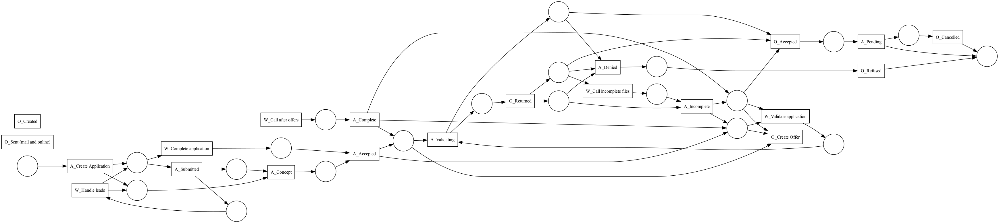

In [12]:
# alpha miner - net (places and transactions)
# general way to visualize net or tree or graph in pm4py - pm4py.view_{petri_net/tree/...}
net, initial_marking, final_marking = pm4py.discover_petri_net_alpha(bpi_log)
pm4py.view_petri_net(net)

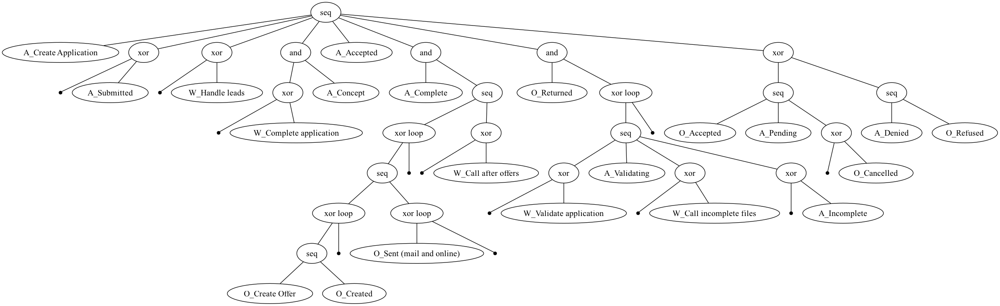

In [13]:
# inductive miner algoritham, we can plot perocess tree, and can save the net same as alpha miner ((places and transactions))
net, initial_marking, final_marking = pm4py.discover_petri_net_inductive(bpi_log)
tree = pm4py.discover_process_tree_inductive(bpi_log)
pm4py.view_process_tree(tree)

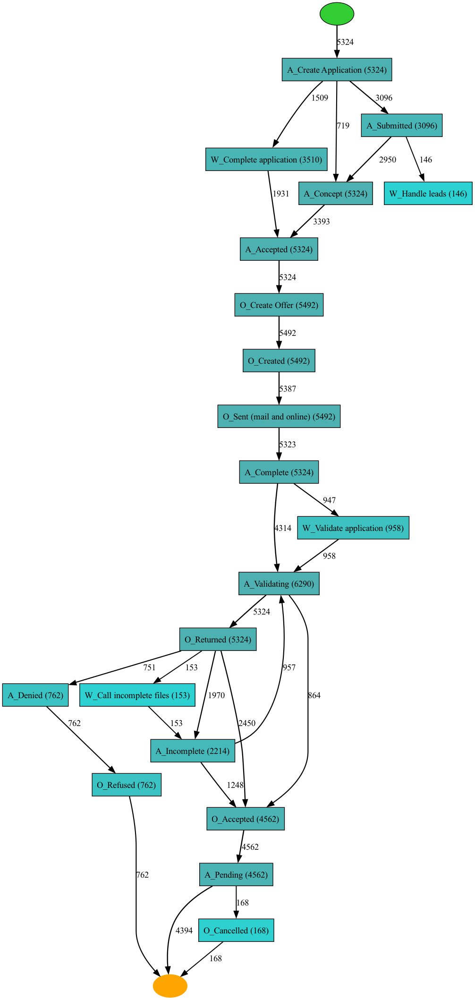

In [14]:
# huristic miner
heu_net = pm4py.discover_heuristics_net(bpi_log, dependency_threshold=0.99)
pm4py.view_heuristics_net(heu_net)

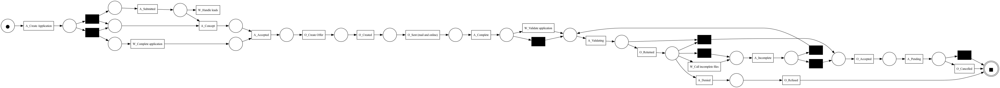

In [15]:
# create and view petri net of huristic miner
net, im, fm = pm4py.discover_petri_net_heuristics(bpi_log, dependency_threshold=0.99)
pm4py.view_petri_net(net, im, fm)

In [16]:
# plotting directly followes graph
# dfg, start_activities, end_activities = pm4py.discover_dfg(trace_log) # dfg with edge number
performance_dfg, start_activities, end_activities = pm4py.discover_performance_dfg(bpi_log) # dfg with duration
# pm4py.save_vis_performance_dfg(performance_dfg, start_activities, end_activities, 'perf_dfg.svg') # to save image, performance dfg can only be saved and then viewed  
# pm4py.view_dfg(performance_dfg, start_activities, end_activities)

# ====================================================

# Data Analysis (Python)

In [117]:
# read data in csv 
zf = zipfile.ZipFile('../data/BPI_Challenge_2017_filtered.zip') 
trace = pd.read_csv(zf.open('BPI_Challenge_2017.csv'), sep=',')
trace.head(10)

,Case ID,Activity,Resource,Start Timestamp,Complete Timestamp,Variant,Variant index,lifecycle:transition,EventOrigin,EventID,...,ApplicationType,RequestedAmount,FirstWithdrawalAmount,NumberOfTerms,Accepted,MonthlyCost,Selected,CreditScore,OfferedAmount,OfferID
0,Application_652823628,A_Create Application,User_1,2016-01-01 10:51:15.304,2016-01-01 10:51:15.304,Variant 9,9,complete,Application,Application_652823628,...,New credit,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Application_652823628,A_Submitted,User_1,2016-01-01 10:51:15.352,2016-01-01 10:51:15.352,Variant 9,9,complete,Application,ApplState_1582051990,...,New credit,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Application_652823628,A_Concept,User_1,2016-01-01 10:52:36.413,2016-01-01 10:52:36.413,Variant 9,9,complete,Application,ApplState_642383566,...,New credit,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Application_652823628,A_Accepted,User_52,2016-01-02 12:23:04.299,2016-01-02 12:23:04.299,Variant 9,9,complete,Application,ApplState_99568828,...,New credit,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Application_652823628,O_Create Offer,User_52,2016-01-02 12:29:03.994,2016-01-02 12:29:03.994,Variant 9,9,complete,Offer,Offer_148581083,...,New credit,20000.0,20000.0,44.0,True,498.29,True,979.0,20000.0,NaN
5,Application_652823628,O_Created,User_52,2016-01-02 12:29:05.354,2016-01-02 12:29:05.354,Variant 9,9,complete,Offer,OfferState_1514834199,...,New credit,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Offer_148581083
6,Application_652823628,O_Sent (mail and online),User_52,2016-01-02 12:30:28.606,2016-01-02 12:30:28.606,Variant 9,9,complete,Offer,OfferState_2051164740,...,New credit,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Offer_148581083
7,Application_652823628,A_Complete,User_52,2016-01-02 12:30:28.633,2016-01-02 12:30:28.633,Variant 9,9,complete,Application,ApplState_946455804,...,New credit,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,Application_652823628,A_Validating,User_117,2016-01-13 14:10:55.973,2016-01-13 14:10:55.973,Variant 9,9,complete,Application,ApplState_752879093,...,New credit,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Application_652823628,O_Returned,User_117,2016-01-13 14:11:03.569,2016-01-13 14:11:03.569,Variant 9,9,complete,Offer,OfferState_1310330551,...,New credit,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Offer_148581083


In [118]:

# Identify rows where 'O_Create Offer' is followed by 'O_Created' in the 'Activity' column
mask = (trace['Activity'] == 'O_Create Offer') & (trace['Activity'].shift(-1) == 'O_Created')

for i in range(len(mask)-1):
    if ((not mask[i]) & mask[i+1]):
        trace['OfferID'][i+1] = trace['OfferID'][i+2]


In [119]:
mask = (trace['EventOrigin'] == 'Offer')
eventID = ""
for i in range(len(mask)):
    if (mask[i]):
        if (trace['FirstWithdrawalAmount'][i] > 0):
            FirstWithdrawalAmount = trace['FirstWithdrawalAmount'][i]
            NumberOfTerms = trace['NumberOfTerms'][i]
            Accepted = trace['Accepted'][i]
            MonthlyCost = trace['MonthlyCost'][i]
            Selected = trace['Selected'][i]
            CreditScore = trace['CreditScore'][i] 
            OfferedAmount = trace['OfferedAmount'][i]
            eventID = trace['EventID'][i]
        elif (trace['OfferID'][i] == eventID):
            trace['FirstWithdrawalAmount'][i] = FirstWithdrawalAmount
            trace['NumberOfTerms'][i] = NumberOfTerms 
            trace['Accepted'][i] = Accepted
            trace['MonthlyCost'][i] = MonthlyCost 
            trace['Selected'][i] = Selected 
            trace['CreditScore'][i] = CreditScore 
            trace['OfferedAmount'][i] = OfferedAmount 


In [120]:
trace.head(25)

,Case ID,Activity,Resource,Start Timestamp,Complete Timestamp,Variant,Variant index,lifecycle:transition,EventOrigin,EventID,...,ApplicationType,RequestedAmount,FirstWithdrawalAmount,NumberOfTerms,Accepted,MonthlyCost,Selected,CreditScore,OfferedAmount,OfferID
0,Application_652823628,A_Create Application,User_1,2016-01-01 10:51:15.304,2016-01-01 10:51:15.304,Variant 9,9,complete,Application,Application_652823628,...,New credit,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Application_652823628,A_Submitted,User_1,2016-01-01 10:51:15.352,2016-01-01 10:51:15.352,Variant 9,9,complete,Application,ApplState_1582051990,...,New credit,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Application_652823628,A_Concept,User_1,2016-01-01 10:52:36.413,2016-01-01 10:52:36.413,Variant 9,9,complete,Application,ApplState_642383566,...,New credit,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Application_652823628,A_Accepted,User_52,2016-01-02 12:23:04.299,2016-01-02 12:23:04.299,Variant 9,9,complete,Application,ApplState_99568828,...,New credit,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Application_652823628,O_Create Offer,User_52,2016-01-02 12:29:03.994,2016-01-02 12:29:03.994,Variant 9,9,complete,Offer,Offer_148581083,...,New credit,20000.0,20000.0,44.0,True,498.29,True,979.0,20000.0,Offer_148581083
5,Application_652823628,O_Created,User_52,2016-01-02 12:29:05.354,2016-01-02 12:29:05.354,Variant 9,9,complete,Offer,OfferState_1514834199,...,New credit,20000.0,20000.0,44.0,True,498.29,True,979.0,20000.0,Offer_148581083
6,Application_652823628,O_Sent (mail and online),User_52,2016-01-02 12:30:28.606,2016-01-02 12:30:28.606,Variant 9,9,complete,Offer,OfferState_2051164740,...,New credit,20000.0,20000.0,44.0,True,498.29,True,979.0,20000.0,Offer_148581083
7,Application_652823628,A_Complete,User_52,2016-01-02 12:30:28.633,2016-01-02 12:30:28.633,Variant 9,9,complete,Application,ApplState_946455804,...,New credit,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,Application_652823628,A_Validating,User_117,2016-01-13 14:10:55.973,2016-01-13 14:10:55.973,Variant 9,9,complete,Application,ApplState_752879093,...,New credit,20000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Application_652823628,O_Returned,User_117,2016-01-13 14:11:03.569,2016-01-13 14:11:03.569,Variant 9,9,complete,Offer,OfferState_1310330551,...,New credit,20000.0,20000.0,44.0,True,498.29,True,979.0,20000.0,Offer_148581083


In [121]:
# get persentage of missing values in a column
percent_missing = trace.isnull().sum() * 100 / len(trace)
missing_value_df = pd.DataFrame({'column_name': trace.columns,
                                 'percent_missing': percent_missing})

# extract list of coumns which are more then 30%
miss_ls = list(percent_missing[percent_missing>30].keys())

In [122]:
# save missing val information
missing_value_df.to_csv('../data/new_missing_vals_bpi.csv',index=False)
missing_value_df.head()

,column_name,percent_missing
Case ID,Case ID,0.0
Activity,Activity,0.0
Resource,Resource,0.0
Start Timestamp,Start Timestamp,0.0
Complete Timestamp,Complete Timestamp,0.0


## Adding Time features 

In [103]:
# adding month and year as feature
trace['year'] = trace['startTime'].dt.year
trace['month'] = trace['startTime'].dt.month

In [123]:
# converting dataframe to event log
trace_log = pm4py.format_dataframe(trace, case_id='Case ID', activity_key='Activity', timestamp_key='Complete Timestamp', start_timestamp_key='Start Timestamp')
trace_log = pm4py.convert_to_event_log(trace_log)

In [113]:
# adding lead and waiting time
# @@approx_bh_partial_lead_time	- Incremental lead time associated to the event
# @@approx_bh_overall_wasted_time - Difference between the partial lead time and the partial cycle time values (for us same as above, as no cylce time for us)
# @@approx_bh_this_wasted_time -	Wasted time ONLY with regards to the activity described by the ‘interval’ even (time difference between activities)
trace_log = interval_lifecycle.assign_lead_cycle_time(trace_log)

In [132]:
print(trace_log[0])

{'attributes': {'concept:name': 'Application_1000158214'}, 'events': [{'concept:name': 'A_Create Application', 'Resource': 'User_1', 'Start Timestamp': Timestamp('2016-06-02 12:14:26.844000+0000', tz='UTC'), 'time:timestamp': Timestamp('2016-06-02 12:14:26.844000+0000', tz='UTC'), 'Variant': 'Variant 2', 'Variant index': 2, 'lifecycle:transition': 'complete', 'EventOrigin': 'Application', 'EventID': 'Application_1000158214', 'Action': 'Created', 'LoanGoal': 'Home improvement', 'ApplicationType': 'New credit', 'RequestedAmount': 12500.0, 'FirstWithdrawalAmount': nan, 'NumberOfTerms': nan, 'Accepted': nan, 'MonthlyCost': nan, 'Selected': nan, 'CreditScore': nan, 'OfferedAmount': nan, 'OfferID': nan, '@@index': 23052, 'start_timestamp': Timestamp('2016-06-02 12:14:26.844000+0000', tz='UTC'), 'case:concept:name': 'Application_1000158214'}, '..', {'concept:name': 'A_Pending', 'Resource': 'User_90', 'Start Timestamp': Timestamp('2016-06-10 13:02:01.278000+0000', tz='UTC'), 'time:timestamp': 

In [133]:
# To extract target varaible, 
# if event starts with the name decleration rejected it is considered as rejected application
accepted = []
for trace in trace_log:
    flag = False
    for i,event in enumerate(trace):
        if "O_Accepted" in event['concept:name']:
            flag = True
            break
    
    if flag:
        accepted.append(1)
    else:
        accepted.append(0)

In [134]:
# convert logs to dataframe
df = pm4py.convert_to_dataframe(trace_log)
df.head()

,concept:name,Resource,Start Timestamp,time:timestamp,Variant,Variant index,lifecycle:transition,EventOrigin,EventID,Action,...,NumberOfTerms,Accepted,MonthlyCost,Selected,CreditScore,OfferedAmount,OfferID,@@index,start_timestamp,case:concept:name
0,A_Create Application,User_1,2016-06-02 12:14:26.844000+00:00,2016-06-02 12:14:26.844000+00:00,Variant 2,2,complete,Application,Application_1000158214,Created,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23052,2016-06-02 12:14:26.844000+00:00,Application_1000158214
1,A_Submitted,User_1,2016-06-02 12:14:26.885000+00:00,2016-06-02 12:14:26.885000+00:00,Variant 2,2,complete,Application,ApplState_277536765,statechange,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23053,2016-06-02 12:14:26.885000+00:00,Application_1000158214
2,A_Concept,User_1,2016-06-02 12:15:36.773000+00:00,2016-06-02 12:15:36.773000+00:00,Variant 2,2,complete,Application,ApplState_1547990892,statechange,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23054,2016-06-02 12:15:36.773000+00:00,Application_1000158214
3,A_Accepted,User_32,2016-06-06 10:10:07.694000+00:00,2016-06-06 10:10:07.694000+00:00,Variant 2,2,complete,Application,ApplState_226397461,statechange,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,23056,2016-06-06 10:10:07.694000+00:00,Application_1000158214
4,O_Create Offer,User_32,2016-06-06 10:12:02.402000+00:00,2016-06-06 10:12:02.402000+00:00,Variant 2,2,complete,Offer,Offer_927137349,Created,...,57.0,True,250.0,True,929.0,12500.0,Offer_927137349,23057,2016-06-06 10:12:02.402000+00:00,Application_1000158214


## Feature engineering before visualization 

### Cheking data types

In [136]:
# check type and correct if needed
df.dtypes

concept:name                          object
Resource                              object
Start Timestamp          datetime64[ns, UTC]
time:timestamp           datetime64[ns, UTC]
Variant                               object
Variant index                          int64
lifecycle:transition                  object
EventOrigin                           object
EventID                               object
Action                                object
LoanGoal                              object
ApplicationType                       object
RequestedAmount                      float64
FirstWithdrawalAmount                float64
NumberOfTerms                        float64
Accepted                              object
MonthlyCost                          float64
Selected                              object
CreditScore                          float64
OfferedAmount                        float64
OfferID                               object
@@index                                int64
start_time

### Removing outliers

In [137]:
num_columns = df.select_dtypes(include='number')
num_columns.columns

Index(['Variant index', 'RequestedAmount', 'FirstWithdrawalAmount',
       'NumberOfTerms', 'MonthlyCost', 'CreditScore', 'OfferedAmount',
       '@@index'],
      dtype='object')

In [142]:
fig = go.Figure()
fig.add_trace(go.Box(y=num_columns['RequestedAmount'], name='Requested Amount',
                marker_color = 'indianred'))
fig.add_trace(go.Box(y=num_columns['FirstWithdrawalAmount'], name = 'First Withdrawal Amount',
                marker_color = 'lightseagreen'))
fig.add_trace(go.Box(y=num_columns['NumberOfTerms'], name='Number Of Terms',
                marker_color = 'slateblue'))
fig.add_trace(go.Box(y=num_columns['MonthlyCost'], name = 'Monthly Cost',
                marker_color = 'yellowgreen'))
fig.add_trace(go.Box(y=num_columns['CreditScore'], name = 'Credit Score',
                marker_color = 'red'))
fig.add_trace(go.Box(y=num_columns['OfferedAmount'], name = 'Offered Amount',
                marker_color = 'blue'))

# Update the layout to show the axis-title
fig.update_layout(xaxis_title='Variable', yaxis_title='Value')

# Update the layout to show the title
fig.update_layout(title="Box Plot for Requested Amount, First Withdrawal Amount, Number Of Terms, Monthly Cost, Credit Score & Offered Amount")

fig.show()


In [30]:
# clearly visible from the above plot anything above 200000 is outlier
# simply removing the rows where values are bigger then 200000, will use gernalize box-plot code pipeline if we use this feature 
threshold_val = 200000
df = df[df['RequestedAmount_0']<threshold_val]
df = df[df['OverspentAmount']<threshold_val]
df = df[df['RequestedBudget']<threshold_val]
df = df[df['TotalDeclared']<threshold_val]

In [251]:
num_columns = df.select_dtypes(include='number')

fig = go.Figure()
fig.add_trace(go.Box(y=num_columns['RequestedAmount_0'], name='Requested Amount',
                marker_color = 'indianred'))
fig.add_trace(go.Box(y=num_columns['OverspentAmount'], name = 'Overspent Amount',
                marker_color = 'lightseagreen'))
fig.add_trace(go.Box(y=num_columns['RequestedBudget'], name='Requested Budget',
                marker_color = 'slateblue'))
fig.add_trace(go.Box(y=num_columns['TotalDeclared'], name = 'Total Declared',
                marker_color = 'yellowgreen'))

# Update the layout to show the axis-title
fig.update_layout(xaxis_title='Variable', yaxis_title='Value')

# Update the layout to show the title
fig.update_layout(title="Box Plot for Requested Amount, Overspent Amount, Requested Budget & Total Declaration with threshold value of 2 Million")

fig.show()

## Separating trace and event attributes

In [31]:
# iterate over first trace case and check if all values are same, if same it is trace attr else event attr

trace_attr  = []
event_attr = []

for name, group in df.groupby(['case']):
    for col in group.columns:
        if len(set(list(group[col])))==1:
            trace_attr.append(col)
        else:
            event_attr.append(col)
    break

# we want to analys the starting month of the trace, so considering it as a trace attribute as well
trace_attr = ['month'] + trace_attr 

# we also want to analyse declerations with event attributes 
event_attr = ['case'] + event_attr + ['declerations']


In [32]:
# create a dict for the trace attributes, to keep the first row from each column when doing groupby below 
agg_dict = {}

rejected_cols = []
for attr in trace_attr:
    if attr!='case':
        agg_dict[attr] = 'first'

# create trace dataframe using groupby
trace_df = df.groupby('case').agg(agg_dict).reset_index()
trace_df.head()

,case,month,RequestedAmount_0,Overspent,travel permit number,OverspentAmount,RequestedBudget,ProjectNumber,TaskNumber,TotalDeclared,BudgetNumber,ActivityNumber,OrganizationalEntity,year,declerations
0,travel permit 10022,2,395.000000,False,travel permit number 10023,-50.662542,2134.047941,UNKNOWN,UNKNOWN,683.176706,budget 1136,UNKNOWN,organizational unit 65466,2018,accepted
1,travel permit 10040,2,2129.846049,False,travel permit number 10041,-646.643989,2531.512736,project 10042,task 427,2655.207272,budget 1136,UNKNOWN,organizational unit 65466,2018,accepted
2,travel permit 10060,2,772.458998,False,travel permit number 10061,0.000000,0.000000,UNKNOWN,UNKNOWN,0.000000,budget 922,UNKNOWN,organizational unit 65458,2018,accepted
3,travel permit 10066,2,79.000000,False,travel permit number 10067,-18.925474,64.878503,project 10068,task 427,71.195831,budget 994,UNKNOWN,organizational unit 65460,2018,accepted
4,travel permit 10077,2,648.000000,False,travel permit number 10078,-1373.918112,1108.578485,UNKNOWN,UNKNOWN,658.505131,budget 3751,UNKNOWN,organizational unit 65455,2018,accepted


In [33]:
# create event dataframe
events_df = df[event_attr]
events_df.head()

,case,event,startTime,completeTime,org:resource,event_id,org:role,month,time:timestamp,start_timestamp,@@approx_bh_partial_lead_time,@@approx_bh_this_wasted_time,declerations
0,travel permit 10022,Permit SUBMITTED by EMPLOYEE,2018-02-20 13:51:27,2018-02-20 13:51:27,STAFF MEMBER,st_step 10031_0,EMPLOYEE,2,2018-02-20 13:51:27,2018-02-20 13:51:27,0.0,0.0,accepted
1,travel permit 10022,Permit APPROVED by ADMINISTRATION,2018-02-20 13:51:34,2018-02-20 13:51:34,STAFF MEMBER,st_step 10030_0,ADMINISTRATION,2,2018-02-20 13:51:34,2018-02-20 13:51:34,7.0,7.0,accepted
2,travel permit 10022,Permit APPROVED by BUDGET OWNER,2018-02-20 16:27:33,2018-02-20 16:27:33,STAFF MEMBER,st_step 10029_0,BUDGET OWNER,2,2018-02-20 16:27:33,2018-02-20 16:27:33,9366.0,9359.0,accepted
3,travel permit 10022,Permit FINAL_APPROVED by SUPERVISOR,2018-02-21 12:58:49,2018-02-21 12:58:49,STAFF MEMBER,st_step 10028_0,SUPERVISOR,2,2018-02-21 12:58:49,2018-02-21 12:58:49,32842.0,23476.0,accepted
4,travel permit 10022,Start trip,2018-03-17 00:00:00,2018-03-17 00:00:00,STAFF MEMBER,rv_travel permit 10022_6,EMPLOYEE,3,2018-03-17 00:00:00,2018-03-17 00:00:00,659313.0,626471.0,accepted


In [34]:
trace_df.shape

(7064, 15)

In [35]:
events_df.shape

(86557, 13)

## Data Visualization

In [178]:
# perfrom basic analysis 
profile = ProfileReport(trace_df, title="Pandas Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### Visualizing Trace Attributes

In [36]:
# categoric data
# keeping only low cardinality values
cat_columns = trace_df.select_dtypes(include='O')
cat_columns = cat_columns[['TaskNumber', 'OrganizationalEntity', 'year', 'month','Overspent','declerations']]
cat_columns.head()

# numeric data
num_columns = trace_df.select_dtypes(include='number')
num_columns.head()
cat_columns.shape, num_columns.shape

((7064, 6), (7064, 4))

Text(0.5, 1.0, 'Number of Traces wrt Task numbers')

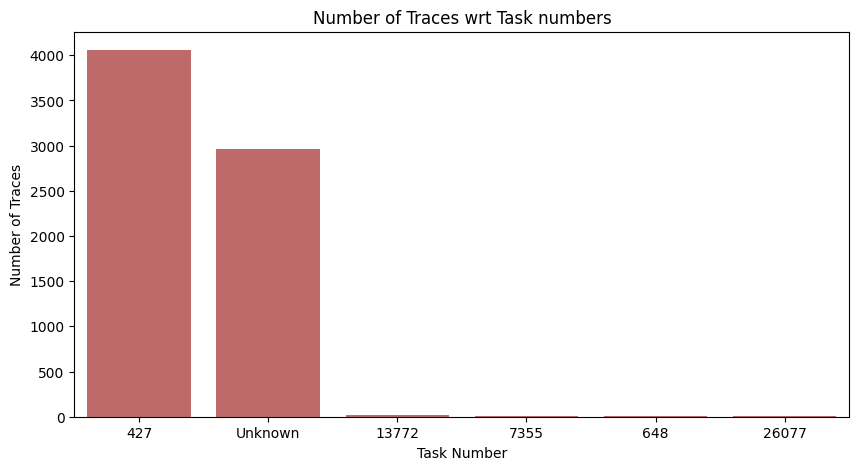

In [258]:
fig = plt.figure(figsize=(10,5))
ax = fig.add_subplot()
temp = trace_df['TaskNumber'].value_counts()
grid = sns.barplot(x=temp.index, y=temp.values, color ='indianred')


ax.set_xlabel("Task Number")  # set x-axis label
ax.set_ylabel("Number of Traces") # set y-axis label
#plt.xticks(rotation=90)
plt.xticks(range(6), ['427', 'Unknown', '13772','7355','648','26077'])
plt.title('Number of Traces wrt Task numbers')

Text(0.5, 1.0, 'Number of Traces wrt Organizational Entity')

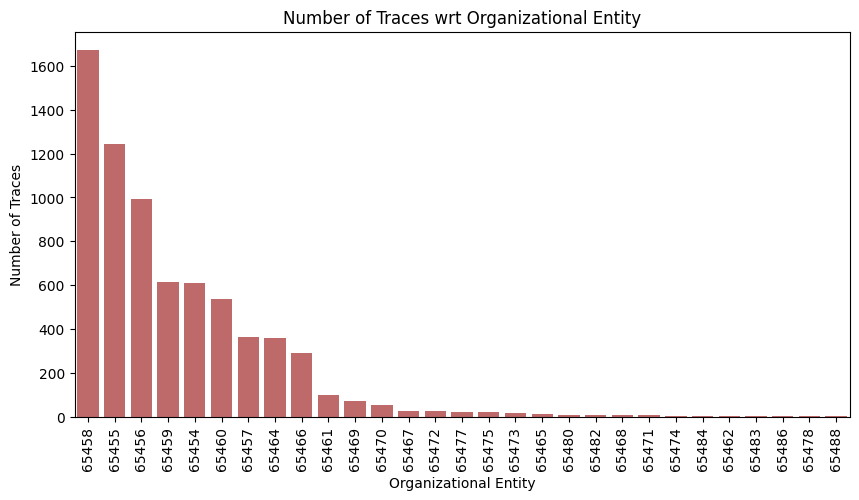

In [259]:
fig = plt.figure(figsize=(10,5))
ax = fig.add_subplot()
temp = trace_df['OrganizationalEntity'].value_counts()
grid = sns.barplot(x=temp.index, y=temp.values, color ='indianred')


ax.set_xlabel("Organizational Entity")  # set x-axis label
ax.set_ylabel("Number of Traces") # set y-axis label
plt.xticks(rotation=90)
plt.xticks(range(29), ['65458', '65455', '65456','65459','65454','65460','65457','65464','65466','65461','65469','65470','65467','65472','65477','65475','65473','65465','65480','65482','65468','65471','65474','65484','65462','65483','65486','65478','65488'])
plt.title('Number of Traces wrt Organizational Entity')

Text(0.5, 1.0, 'Number of Traces wrt Years')

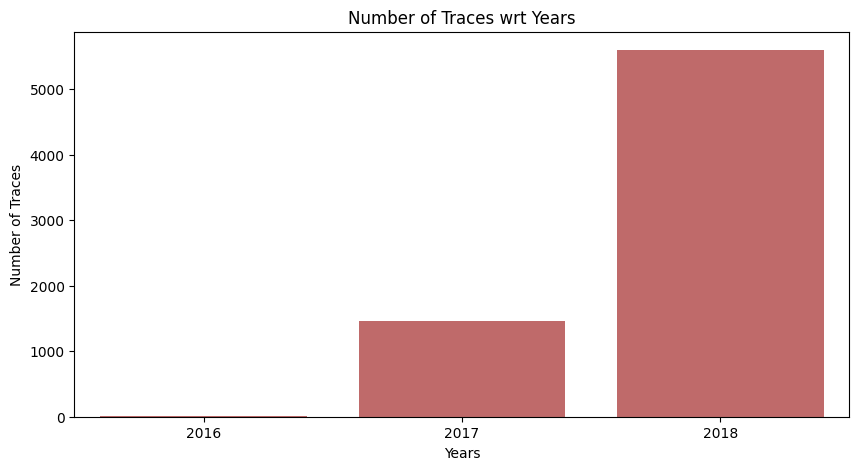

In [260]:
fig = plt.figure(figsize=(10,5))
ax = fig.add_subplot()
temp = trace_df['year'].value_counts()
grid = sns.barplot(x=temp.index, y=temp.values, color ='indianred')


ax.set_xlabel("Years")  # set x-axis label
ax.set_ylabel("Number of Traces") # set y-axis label
plt.title('Number of Traces wrt Years')

Text(0.5, 1.0, 'Number of Traces wrt Months')

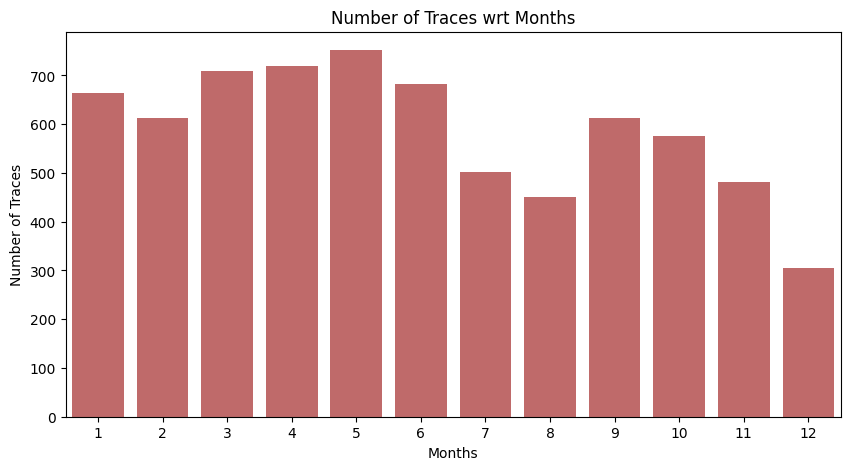

In [261]:
fig = plt.figure(figsize=(10,5))
ax = fig.add_subplot()
temp = trace_df['month'].value_counts()
grid = sns.barplot(x=temp.index, y=temp.values, color ='indianred')


ax.set_xlabel("Months")  # set x-axis label
ax.set_ylabel("Number of Traces") # set y-axis label
plt.title('Number of Traces wrt Months')

Text(0.5, 1.0, 'Number of Traces wrt Overspent Amount')

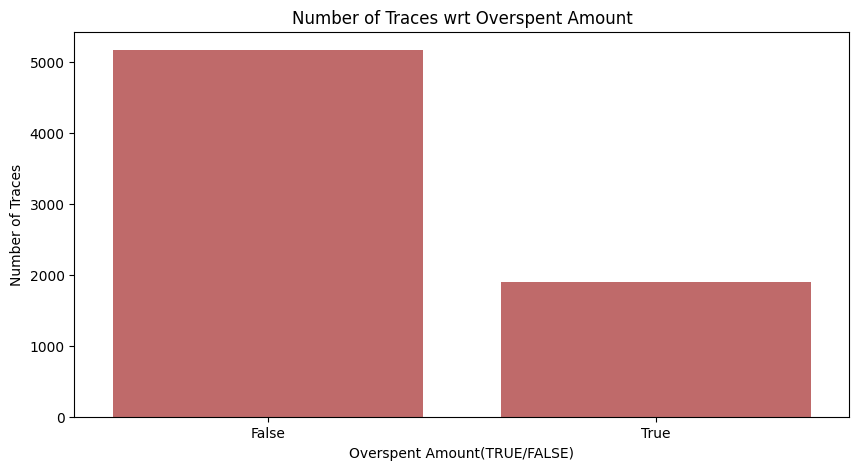

In [262]:
fig = plt.figure(figsize=(10,5))
ax = fig.add_subplot()
temp = trace_df['Overspent'].value_counts()
grid = sns.barplot(x=temp.index, y=temp.values, color ='indianred')


ax.set_xlabel("Overspent Amount(TRUE/FALSE)")  # set x-axis label
ax.set_ylabel("Number of Traces") # set y-axis label
plt.title('Number of Traces wrt Overspent Amount')

Text(0.5, 1.0, 'Number of Traces wrt Declarations')

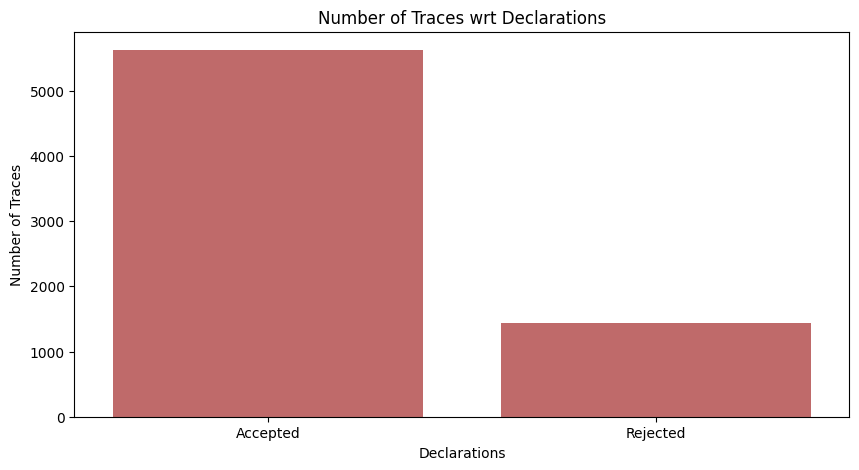

In [263]:
fig = plt.figure(figsize=(10,5))
ax = fig.add_subplot()
temp = trace_df['declerations'].value_counts()
grid = sns.barplot(x=temp.index, y=temp.values, color ='indianred')


ax.set_xlabel("Declarations")  # set x-axis label
ax.set_ylabel("Number of Traces") # set y-axis label
plt.xticks(range(2), ['Accepted', 'Rejected'])
plt.title('Number of Traces wrt Declarations')

Text(0.5, 1.0, 'Acceptance and Rejection rate of Declarations wrt Task numbers')

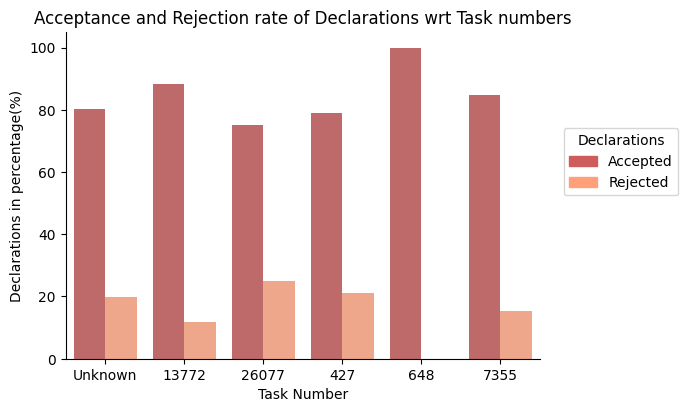

In [264]:
x, y = 'TaskNumber', 'declerations'
df1 = cat_columns.groupby(x)[y].value_counts(normalize=True)
df1 = df1.mul(100)
df1 = df1.rename('percent').reset_index()
#grid = sns.catplot(x=x, y='percent', hue=y, kind='bar', data=df1, height=4, aspect=1.4)
grid = sns.catplot(x=x, y='percent', hue=y, kind='bar', data=df1,legend = False, height=4, aspect=1.4, palette=sns.color_palette(['indianred', 'lightsalmon']))
ax = grid.axes[0][0]
# Create a list of color patches
patches = [mpatches.Patch(color=color, label=label) for color, label in zip(sns.color_palette(['indianred', 'lightsalmon']), ["Accepted", "Rejected"])]

# Create a custom legend
legend = ax.legend(title="Declarations", handles=patches, loc=(1.05, 0.5))

ax.set_xlabel("Task Number")  # set x-axis label
ax.set_ylabel("Declarations in percentage(%)") # set y-axis label
#plt.xticks(rotation=90)
plt.xticks(range(6), ['Unknown', '13772', '26077','427','648','7355'])
plt.title('Acceptance and Rejection rate of Declarations wrt Task numbers')

Text(0.5, 1.0, 'Rejection Rate of Declarations by Organizational Entity')

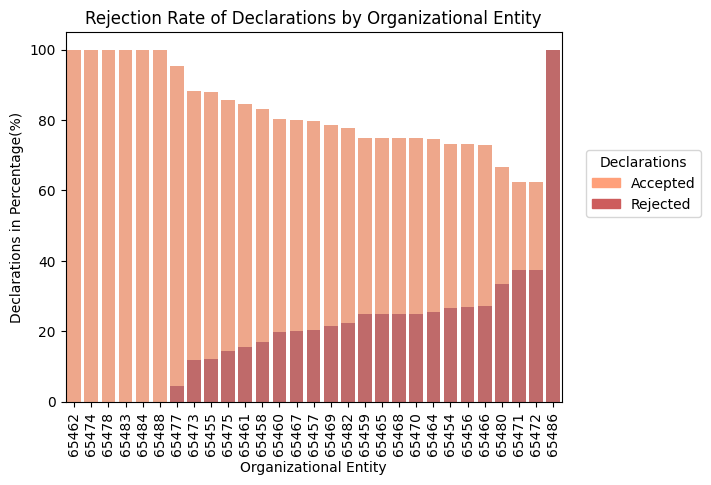

In [99]:

x, y = 'OrganizationalEntity', 'declerations'
df1 = cat_columns.groupby(x)[y].value_counts(normalize=True)
df1 = df1.mul(100)
df1 = df1.rename('percent').reset_index()
df1 = df1.sort_values(by=['declerations','percent'],ascending=[True,False])

df1['OrganizationalEntity'] = df1['OrganizationalEntity'].str[-5:]


#df1 = df1.sort_values(by='percent', ascending=0)
grid = sns.barplot(x=x, y='percent', hue=y, data=df1, dodge=False, palette=sns.color_palette(['lightsalmon','indianred']))

# Create a list of color patches
patches = [mpatches.Patch(color=color, label=label) for color, label in zip(sns.color_palette(['lightsalmon','indianred']), ["Accepted","Rejected"])]

# Create a custom legend
legend = grid.legend(title="Declarations", handles=patches, loc=(1.05, 0.5))


grid.set_xlabel("Organizational Entity")  # set x-axis label
grid.set_ylabel("Declarations in Percentage(%)") # set y-axis label

plt.xticks(rotation=90)
plt.title('Rejection Rate of Declarations by Organizational Entity')

In [110]:
#print(df1['declerations'])
print(df1['declerations'].value_counts())


accepted    28
rejected    23
Name: declerations, dtype: int64


Text(0.5, 1.0, 'Acceptance and Rejection rate of Declarations wrt Year')

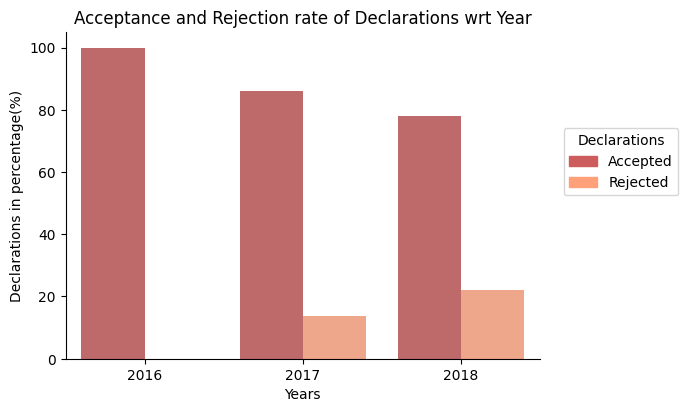

In [266]:
x, y = 'year', 'declerations'
df1 = cat_columns.groupby(x)[y].value_counts(normalize=True)
df1 = df1.mul(100)
df1 = df1.rename('percent').reset_index()
#grid = sns.catplot(x=x, y='percent', hue=y, kind='bar', data=df1, height=4, aspect=1.4)
grid = sns.catplot(x=x, y='percent', hue=y, kind='bar', data=df1,legend = False, height=4, aspect=1.4,palette=sns.color_palette(['indianred', 'lightsalmon']))
ax = grid.axes[0][0]
# Create a list of color patches
patches = [mpatches.Patch(color=color, label=label) for color, label in zip(sns.color_palette(['indianred', 'lightsalmon']), ["Accepted", "Rejected"])]

# Create a custom legend
legend = ax.legend(title="Declarations", handles=patches, loc=(1.05, 0.5))

ax.set_xlabel("Years")  # set x-axis label
ax.set_ylabel("Declarations in percentage(%)") # set y-axis label
#plt.xticks(rotation=90)
plt.title('Acceptance and Rejection rate of Declarations wrt Year')

Text(0.5, 1.0, 'Acceptance and Rejection Rate of Declarations w.r.t. Month')

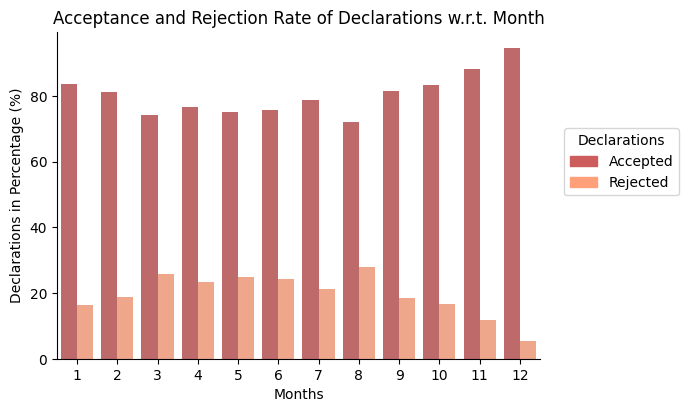

In [267]:
x, y = 'month', 'declerations'
df1 = cat_columns.groupby(x)[y].value_counts(normalize=True)
df1 = df1.mul(100)
df1 = df1.rename('percent').reset_index()
#grid = sns.catplot(x=x, y='percent', hue=y, kind='bar', data=df1, height=4, aspect=1.4)
grid = sns.catplot(x=x, y='percent', hue=y, kind='bar', data=df1,legend = False, height=4, aspect=1.4,palette=sns.color_palette(['indianred', 'lightsalmon']))
ax = grid.axes[0][0]
# Create a list of color patches
patches = [mpatches.Patch(color=color, label=label) for color, label in zip(['indianred', 'lightsalmon'], ["Accepted", "Rejected"])]

# Create a custom legend
legend = ax.legend(title="Declarations", handles=patches, loc=(1.05, 0.5))

ax.set_xlabel("Months")  # set x-axis label
ax.set_ylabel("Declarations in Percentage (%)") # set y-axis label
#plt.xticks(rotation=90)
plt.title('Acceptance and Rejection Rate of Declarations w.r.t. Month')

Text(0.6, 1, 'Rejection Rate for Overspent and Underspent in Declarations')

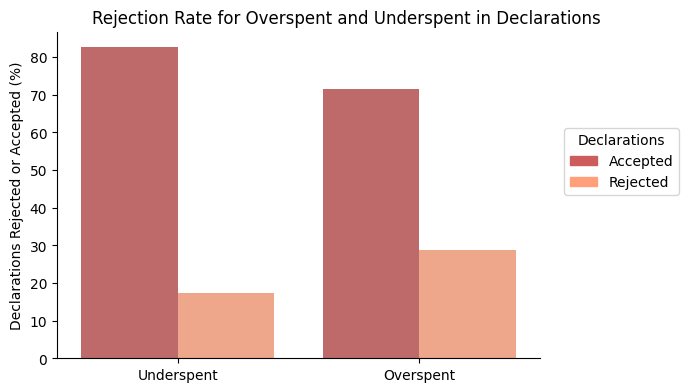

In [268]:
x, y = 'Overspent', 'declerations'
df1 = cat_columns.groupby(x)[y].value_counts(normalize=True)
df1 = df1.mul(100)
df1 = df1.rename('percent').reset_index()
#grid = sns.catplot(x=x, y='percent', hue=y, kind='bar', data=df1, height=4, aspect=1.4)
grid = sns.catplot(x=x, y='percent', hue=y, kind='bar', data=df1, legend = False, height=4, aspect=1.4, palette=sns.color_palette(['indianred', 'lightsalmon']))
ax = grid.axes[0][0]

# Create a list of color patches
patches = [mpatches.Patch(color=color, label=label) for color, label in zip(sns.color_palette(['indianred', 'lightsalmon']), ["Accepted", "Rejected"])]

# Create a custom legend
legend = ax.legend(title="Declarations", handles=patches, loc=(1.05, 0.5))

ax.set_xlabel("")  # set x-axis label
ax.set_ylabel("Declarations Rejected or Accepted (%)") # set y-axis label
plt.xticks(range(2),['Underspent','Overspent'] )
#plt.xticks(rotation=90)
plt.title('Rejection Rate for Overspent and Underspent in Declarations',loc='center',x=0.60,y=1)

array([[<AxesSubplot: title={'center': 'RequestedAmount_0'}>,
        <AxesSubplot: title={'center': 'OverspentAmount'}>],
       [<AxesSubplot: title={'center': 'RequestedBudget'}>,
        <AxesSubplot: title={'center': 'TotalDeclared'}>]], dtype=object)

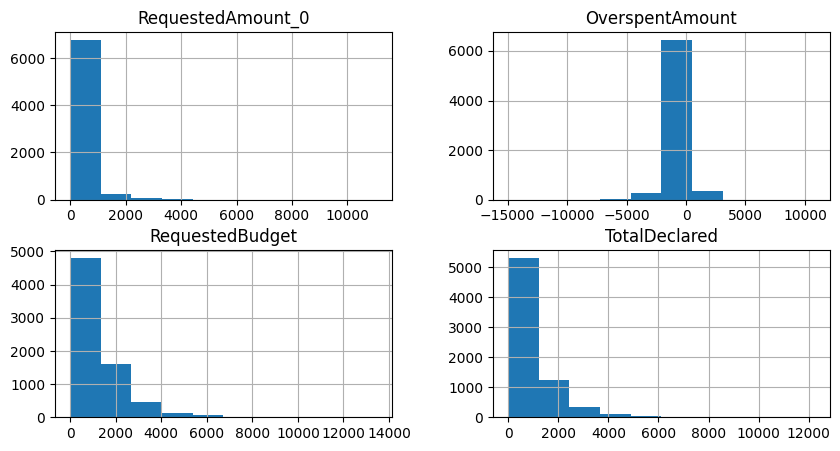

In [269]:
# check data distribution for numeric values
num_columns.hist(figsize=(10,5))
# px.histogram(num_columns, x=num_columns.columns)

Text(0.5, 1.0, 'Heatmap')

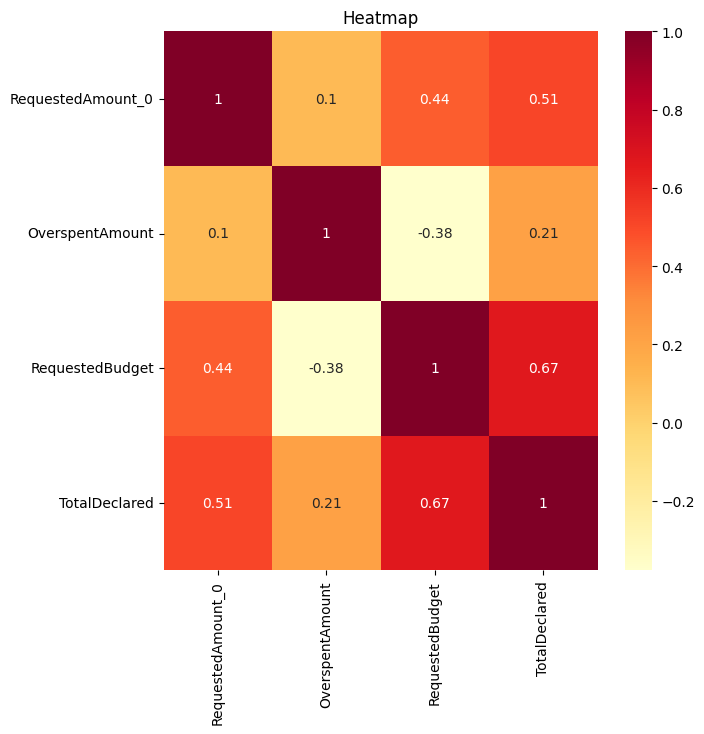

In [270]:
# plotting heat map between numeric variables
fig, ax = plt.subplots(figsize=(7,7)) 
sns.heatmap(num_columns.corr(), annot=True, ax = ax, cmap='YlOrRd')
plt.title('Heatmap')

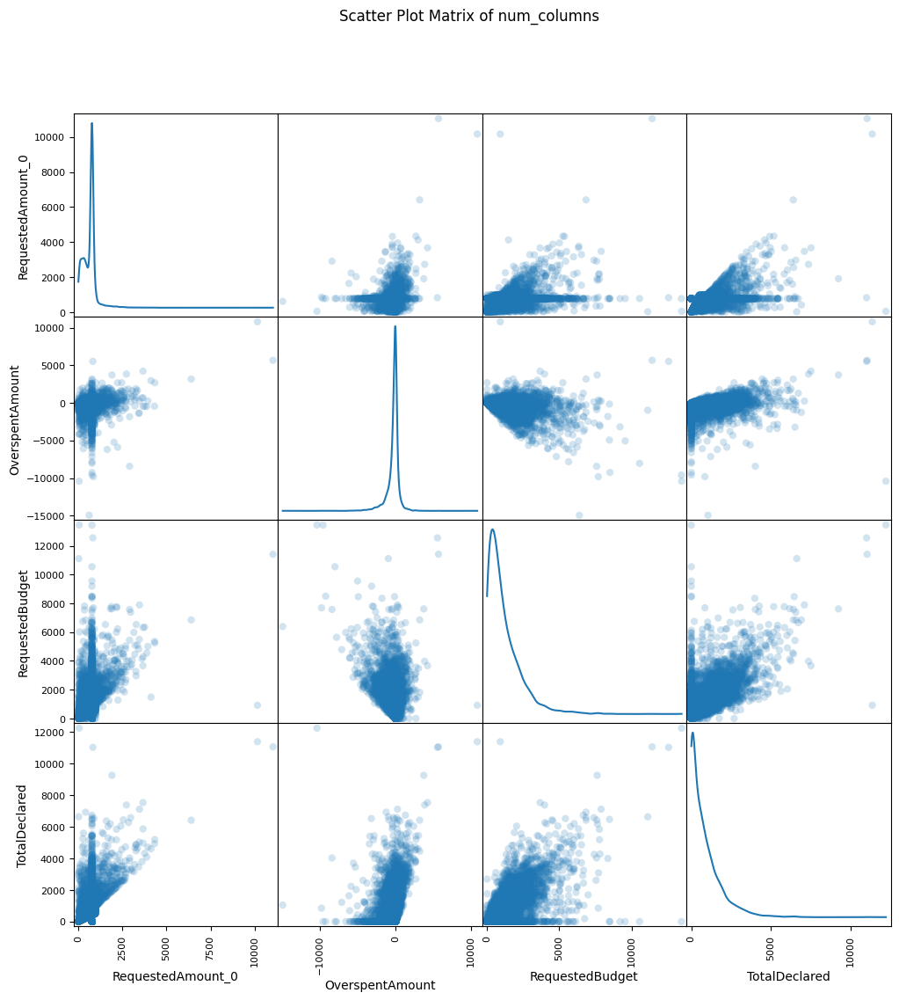

In [271]:
# plot scatter plots
scatter_matrix(num_columns, 
               alpha=0.2, figsize=(12, 12), 
               diagonal='kde', marker='o');
# Add a title to the figure
plt.suptitle("Scatter Plot Matrix of num_columns")

# Show the plot
plt.show()

In [272]:
num_columns['declerations'] = trace_df['declerations']

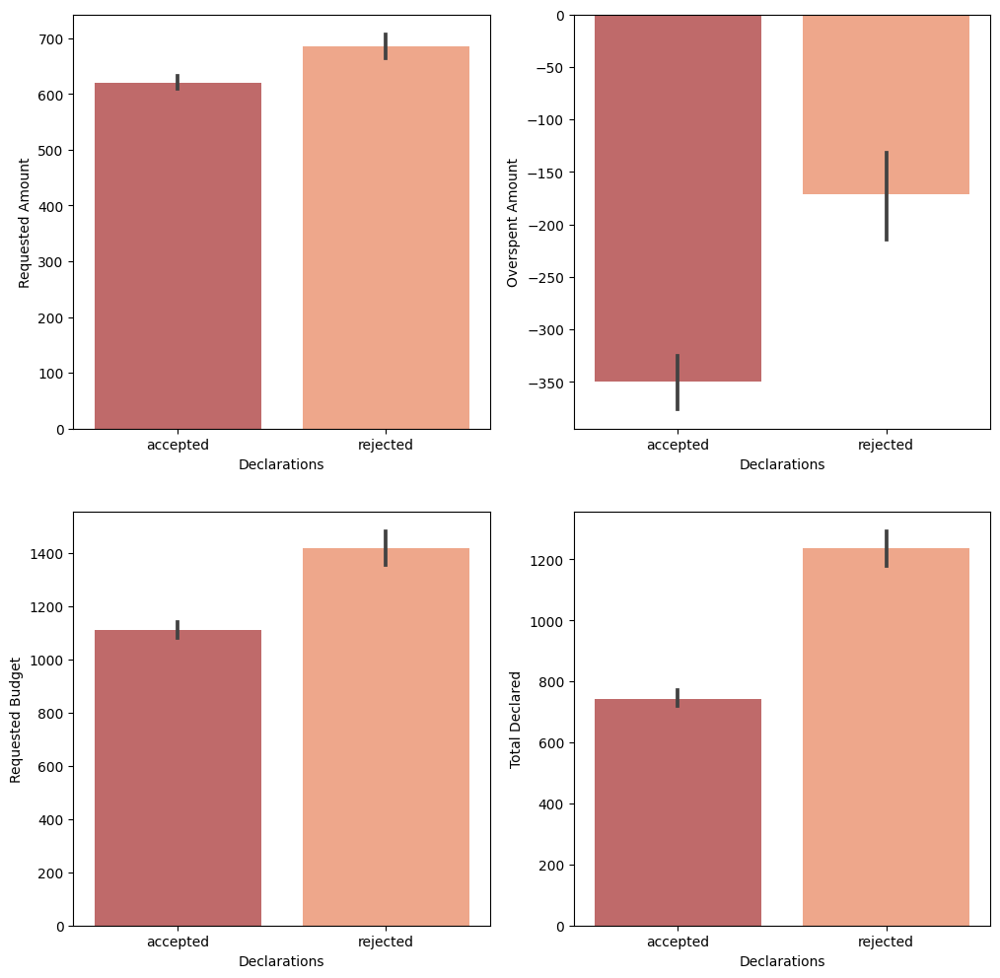

In [273]:
# Create the figure with subplots
fig, ax  = plt.subplots(2,2,figsize=(12,12))

# Plot the first bar plot
sns.barplot(x='declerations', y='RequestedAmount_0', data=num_columns, ax=ax[0,0],palette=sns.color_palette(['indianred', 'lightsalmon']))

# Set the axis label for the first subplot
ax[0,0].set_xlabel("Declarations")
ax[0,0].set_ylabel("Requested Amount")

# Plot the second bar plot
sns.barplot(x='declerations', y='OverspentAmount', data=num_columns, ax=ax[0,1],palette=sns.color_palette(['indianred', 'lightsalmon']))

# Set the axis label for the second subplot
ax[0,1].set_xlabel("Declarations")
ax[0,1].set_ylabel("Overspent Amount")

# Plot the third bar plot
sns.barplot(x='declerations', y='RequestedBudget', data=num_columns, ax=ax[1,0],palette=sns.color_palette(['indianred', 'lightsalmon']))

# Set the axis label for the third subplot
ax[1,0].set_xlabel("Declarations")
ax[1,0].set_ylabel("Requested Budget")

# Plot the fourth bar plot
sns.barplot(x='declerations', y='TotalDeclared', data=num_columns, ax=ax[1,1],palette=sns.color_palette(['indianred', 'lightsalmon']))

# Set the axis label for the fourth subplot
ax[1,1].set_xlabel("Declarations")
ax[1,1].set_ylabel("Total Declared")

# Add a title to the plot
# plt.title("Bar Plot of Declarations vs num_columns")

# Show the plot
plt.show()




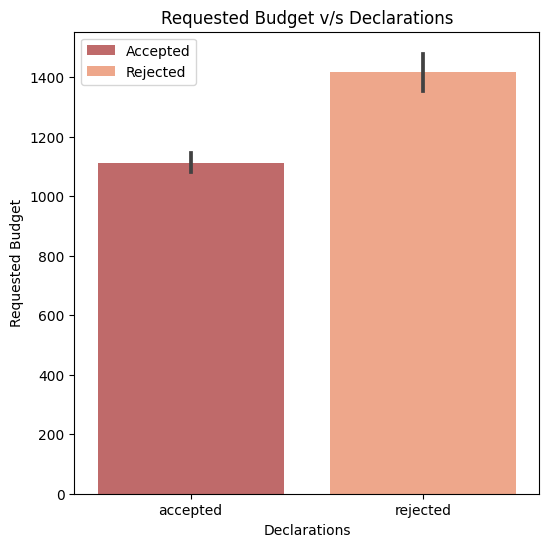

In [274]:
# Create a figure and axes object for the first bar plot
fig1, ax1 = plt.subplots(figsize=(6, 6))

# Plot the first bar plot
sns.barplot(x='declerations', y='RequestedBudget', data=num_columns, palette=sns.color_palette(['indianred', 'lightsalmon']), ax=ax1, label = ["Accepted", "Rejected"])
ax1.legend(title='')

# Set the axis label for the first subplot
ax1.set_xlabel("Declarations")
ax1.set_ylabel("Requested Budget")

# Add a title to the plot
plt.title("Requested Budget v/s Declarations")

# Show the plot
plt.show()



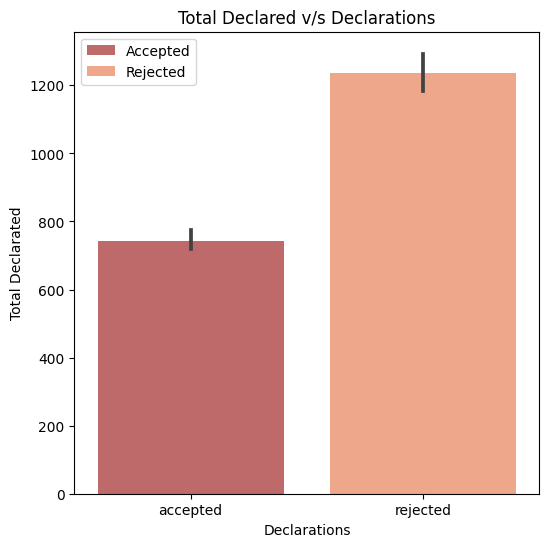

In [275]:
# Create a figure and axes object for the first bar plot
fig1, ax1 = plt.subplots(figsize=(6, 6))

# Plot the first bar plot
sns.barplot(x='declerations', y='TotalDeclared', data=num_columns, palette=sns.color_palette(['indianred', 'lightsalmon']), ax=ax1, label = ["Accepted", "Rejected"])
ax1.legend(title='')

# Set the axis label for the first subplot
ax1.set_xlabel("Declarations")
ax1.set_ylabel("Total Declarated")

# Add a title to the plot
plt.title("Total Declared v/s Declarations")

# Show the plot
plt.show()

## Analysing behaviroul attributes

In [276]:
# grouping by median(to tackle outliers) for differnt numeric columns 
data = events_df.groupby('case').agg({'@@approx_bh_this_wasted_time':'median','@@approx_bh_partial_lead_time':'median','declerations':'first'}).reset_index()
data.head()

,case,@@approx_bh_this_wasted_time,@@approx_bh_partial_lead_time,declerations
0,travel permit 10022,4718.5,1415313.0,accepted
1,travel permit 10040,11749.5,188404.0,accepted
2,travel permit 10060,429899.0,1557448.5,accepted
3,travel permit 10066,3563.0,26250.0,accepted
4,travel permit 10077,33338.0,3677938.0,accepted


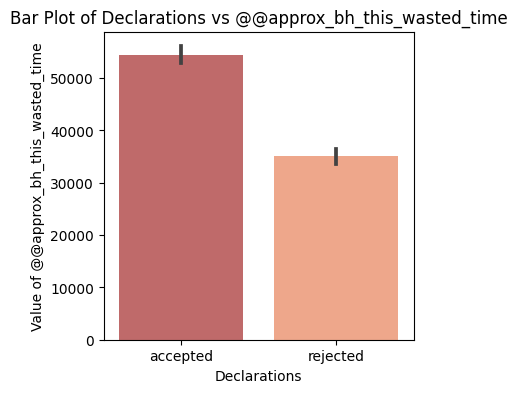

In [277]:
# Create the figure and subplot
fig, ax = plt.subplots(figsize=(4,4))

# Plot the bar plot
sns.barplot(x='declerations', y='@@approx_bh_this_wasted_time', data=data, ax=ax ,palette=sns.color_palette(['indianred', 'lightsalmon']))

# Set the x-axis label
ax.set_xlabel("Declarations")

# Set the y-axis label
ax.set_ylabel("Value of @@approx_bh_this_wasted_time")

# Add a title to the plot
plt.title("Bar Plot of Declarations vs @@approx_bh_this_wasted_time")

# Show the plot
plt.show()

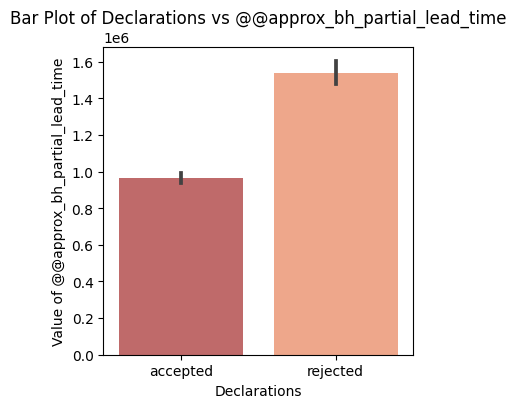

In [278]:
# Create the figure and subplot
fig, ax = plt.subplots(figsize=(4,4))

# Plot the bar plot
sns.barplot(x='declerations', y='@@approx_bh_partial_lead_time', data=data, ax=ax, palette=sns.color_palette(['indianred', 'lightsalmon']))

# Set the x-axis label
ax.set_xlabel("Declarations")

# Set the y-axis label
ax.set_ylabel("Value of @@approx_bh_partial_lead_time")

# Add a title to the plot
plt.title("Bar Plot of Declarations vs @@approx_bh_partial_lead_time")

# Show the plot
plt.show()

# Evaluation Visualization

In [279]:
# read data in csv 
plot = pd.read_csv('D:\TUe\Q2\Advanced Process Mining\Project\APM_BPI_2020-1\data\processed\plot.csv')
#print(plot)
plot = plot.sort_values(by=['Encoding'])
plot["Encoding"] = pd.Categorical(plot["Encoding"], ["Baseline", "Boolean", "Complex", "Frequency"])


In [280]:
import plotly.express as px

fig = px.bar(plot, x='Trace Length', y='F-score', color='Encoding', barmode='group',
             height=500, title='F-score by Trace Length and Encoding for Decision Tree Prediction Model',
             color_discrete_sequence=px.colors.qualitative.Pastel1)
fig.update_layout(title_x=0.22)
fig.update_layout(
    bargap=0.6,
    bargroupgap=0
)

fig.show()



# ======================= END ====================

## EXTRA

### adding time features in a dataframe

In [ ]:
# # loading csv and converting to event log object
# # read data in csv 
# trace = pd.read_csv('../data/Travel Permits (filtered).csv')

# # removing redundant columns from data and converting time to pandas datetime object
# imp_cols = ['case', 'event', 'startTime', 'completeTime', 'OrganizationalEntity',
#        'TotalDeclared', 'Overspent',
#        'RequestedBudget', 'OverspentAmount', 'org:resource']
# trace = trace[imp_cols]
# trace['startTime'] = pd.to_datetime(trace['startTime'])
# trace['completeTime'] = pd.to_datetime(trace['completeTime'])
# # converting dataframe to event log
# trace_log = pm4py.format_dataframe(trace, case_id='case', activity_key='event', timestamp_key='completeTime', start_timestamp_key='startTime')
# trace_log = pm4py.convert_to_event_log(trace_log)


# # data_path = '../data/Travel Permits Filtered.xes'
# # trace_log = pm4py.read_xes(data_path)
# # trace_log = pm4py.format_dataframe(trace_log, case_id='case:id', activity_key='concept:name', timestamp_key='time:timestamp')
# # trace_log = pm4py.convert_to_event_log(trace_log)

In [210]:
# # removing redundant columns from data and converting time to pandas datetime object
# # imp_cols = ['case', 'event', 'startTime', 'completeTime', 'OrganizationalEntity',
# #        'TotalDeclared', 'Overspent',
# #        'RequestedBudget', 'OverspentAmount', 'org:resource']
# # trace = trace[imp_cols]
# trace['startTime'] = pd.to_datetime(trace['startTime'])
# trace['completeTime'] = pd.to_datetime(trace['completeTime'])
# permits = trace

In [211]:
# permits.head()
# permits['startTime'] = pd.to_datetime(permits['startTime'])
# permits['completeTime'] = pd.to_datetime(permits['completeTime'])

In [212]:
# # add year and month column
# permits['year'] = permits['startTime'].dt.year
# permits['month'] = permits['startTime'].dt.month

In [213]:
# # time to complete the activity
# permits['act_completionTime'] = permits['completeTime'] - permits['startTime']
# permits['act_completionTime'] = permits['act_completionTime'].dt.total_seconds()

In [214]:
# # get minimum time for earch trace (when trace started)
# temp_df = pd.DataFrame(permits.groupby(['case'])['startTime'].min())
# temp_df['index'] = temp_df.index
# temp_df.reset_index(drop=True, inplace=True)
# temp_df.columns = ['startTime_min','case']

# # merge with permits
# permits = permits.merge(temp_df,on=['case'])

In [215]:
# # get max time for earch trace (when trace ended)
# temp_df = pd.DataFrame(permits.groupby(['case'])['completeTime'].max())
# temp_df['index'] = temp_df.index
# temp_df.reset_index(drop=True, inplace=True)
# temp_df.columns = ['completeTime_max','case']

# # merge with permits
# permits = permits.merge(temp_df,on=['case'])

In [216]:
# # calculate trace time
# permits['processCompletionTime']=permits['completeTime_max']-permits['startTime_min']
# permits['processCompletionTime'] = permits['processCompletionTime'].dt.total_seconds()

In [217]:
# # calculate time taken between activities and cumulative time
# act_time_taken=[]
# act_inc_time = []
# for name,group in permits.groupby(['case'],sort=False):
#     act_time_taken.append([name,pd.to_datetime(0) - pd.to_datetime(0)])
#     act_inc_time.append([name,pd.to_datetime(0) - pd.to_datetime(0)])
#     act_time=pd.to_datetime(0) - pd.to_datetime(0)
#     for i in range(len(group)-1):
#         st_time_1 = group.iloc[i]['startTime']
#         st_time_2 = group.iloc[i+1]['startTime']
#         diff = st_time_2-st_time_1
#         act_time+=diff
#         act_time_taken.append([name,diff])
#         act_inc_time.append([name,act_time])

# time_diff_df = pd.DataFrame(act_time_taken,columns=['case','act_time_diff'])
# time_inc_df = pd.DataFrame(act_inc_time,columns=['case','act_inc_time'])

# # add with permits
# permits['next_act_time_diff'] = time_diff_df['act_time_diff']
# permits['next_act_time_diff'] = permits['next_act_time_diff'].dt.total_seconds()

# permits['act_inc_time'] = time_inc_df['act_inc_time']
# permits['act_inc_time'] = permits['act_inc_time'].dt.total_seconds()

In [218]:
# permits.head()

### Phase2 behaviroul Plots

In [203]:
# permits = df
# temp = pd.DataFrame(permits[['startTime','OrganizationalEntity','TotalDeclared']]).fillna(0)
# temp

In [204]:
# # count vs totaldeclared next month
# temp = permits[permits['OrganizationalEntity']=='organizational unit 65454']
# temp = temp[temp['startTime'].dt.year==2018]
# temp['month'] = temp['startTime'].dt.month
# temp = temp.groupby('month').agg({'TotalDeclared':'sum', 
#                          'OrganizationalEntity':'count'}).reset_index()
# temp.columns = ['month','TotalDeclared','Application count']
# temp.head()

In [205]:
# temp['TotalDeclared']=temp['TotalDeclared'].shift(-1)
# temp = temp.iloc[:-1,:]
# temp.head()

In [206]:
# temp.corr(method='pearson')

In [207]:
# fig = px.scatter(temp, x="Application count", y="TotalDeclared")
# fig.show()

In [208]:
# # monthly organizational variations
# temp = permits[permits['startTime'].dt.year==2018]
# temp = temp[temp['OrganizationalEntity']!='organizational unit 65466'] # an outlier, decalted amount in million
# temp['month'] = temp['startTime'].dt.month
# temp = temp.groupby([pd.Grouper(key="startTime", freq='M'),'OrganizationalEntity']).sum().reset_index()
# temp.head()

In [209]:
# # plotting in plotly
# fig = px.line(temp, x="startTime", y="TotalDeclared",color='OrganizationalEntity')
# fig.show()

# # plotting in seaborn 
# # # create figure object and axis and pass axis in sns plot
# # fig,ax = plt.subplots(figsize=(14,7))
# # # Group variable using "hue" that will produce lines with different colors
# # sns.lineplot(x="startTime", y="TotalDeclared", hue='OrganizationalEntity' , data=temp,ax=ax)
# # plt.show()